# Matéria Deep Learning
### Professor: Bruno Leonardo

### Alunos: 
- Leandro Ariel Caputo 
- Loyanne Rabelo
- Matheus Augusto Oliveira Santos
- Victor Miranda

Avaliação final

# Transferência de estilo neural


A transferência de estilo neural é uma técnica de otimização usada para pegar duas imagens - uma imagem de conteúdo e uma imagem de referência de estilo (como uma obra de arte de um pintor famoso) - e misturá-las para que a imagem de saída se pareça com a imagem de conteúdo, mas "pintada" no estilo da imagem de referência de estilo.

Isso é implementado otimizando a imagem de saída para corresponder às estatísticas de conteúdo da imagem de conteúdo e às estatísticas de estilo da imagem de referência de estilo. Essas estatísticas são extraídas das imagens usando uma rede convolucional.

Por exemplo, vamos tirar uma imagem deste cachorro e a Composição VII de Wassily Kandinsky:

<img src="https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg" width="500px"/>

[Olhar do Labrador Amarelo ](https://commons.wikimedia.org/wiki/File:YellowLabradorLooking_new.jpg), do Wikimedia Commons por [Elf](https://en.wikipedia.org/wiki/User:Elf). Licença [CC BY-SA 3.0](https://creativecommons.org/licenses/by-sa/3.0/deed.en)

<img src="https://storage.googleapis.com/download.tensorflow.org/example_images/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg" width="500px"/>


Agora, como seria se Kandinsky decidisse pintar a imagem desse Cão exclusivamente com esse estilo? Algo assim?

<img src="https://tensorflow.org/tutorials/generative/images/stylized-image.png" style="width: 500px;"/>


Referência retirada da documentação do tensorflow [style Transfer](https://www.tensorflow.org/tutorials/generative/style_transfer).

## Estilo e conteúdo representados em uma única imagem

Para implementação da técnica de **Transferência de Estilo Neural** as camadas intermediárias de um modelo são utilizadas para obter as representações de conteúdo e estilo de uma par de imagens.
<br><br>

Quando estamos falando de uma CNN, as primeiras camadas de ativação representam elementos de baixo nível, como bordas e texturas. À medida que vamos percorrendo a rede, as camadas finais apresentam elementos de alto nível, como partes específicas de objetos ou elementos da anatomia humana. Esse conceito é explorado no paper [Visualizing and Understanding Convolutional Networks](https://arxiv.org/abs/1311.2901) e nesse [séminario](https://www.youtube.com/watch?v=ghEmQSxT6tw) apresentado pelo autor do estudo.
<br><br>


Levando isso em consideração, na aplicação da técnica de **Transferência de Estilo Neural** é utilizada uma arquitetura de CNN já pré-treinada (normalmente a rede VGG19) com a finalidade de extrair a representação de uma dada imagem, que é passada com entrada no modelo, em diferentes camadas de ativação.

## VGG19

A rede [AlexNet](https://proceedings.neurips.cc/paper/2012/file/c399862d3b9d6b76c8436e924a68c45b-Paper.pdf) foi lançada em 2012 e melhorou as tradicionais redes neurais convolucionais, então podemos entender o VGG como um sucessor do AlexNet. Essa arquitetura foi criada por um grupo em Oxford chamado Visual Geometry Group, e daí o nome VGG. Ela carrega e usa algumas idéias de seus antecessores e as aprimora usando camadas convolucionais profundas para melhorar a precisão.
<br><br>

O objetivo principal para o qual a rede VGG foi projetada era ganhar o ILSVRC(ImageNet Large Scale Visual Recognition Challenge), mas tem sido usada de muitas outras maneiras.

> - Usado como uma boa arquitetura de classificação para muitos outros conjuntos de dados. Como os autores disponibilizaram os modelos ao público, eles podem ser usados ​​da maneira original ou então modificados para outras tarefas semelhantes. 

> - Aprendizado de transferência: também pode ser usado para tarefas de reconhecimento facial. 

> - Os pesos estão facilmente disponíveis com outros frameworks como keras para que possam ser ajustados e usados ​​como quiser. 

> - Cálculo do Loss de conteúdo e estilo usando a rede VGG-19

<br><br>
<img src="https://raw.githubusercontent.com/maods2/Neural-Style-Transfer-files/main/data/notebook-images/vgg.png" style="width: 400px"/>


Referências: [VGG content](https://iq.opengenus.org/vgg19-architecture/#:~:text=VGG19%20is%20a%20variant%20of,VGG19%20has%2019.6%20billion%20FLOPs.),  [Imagem](https://towardsdatascience.com/tagged/vgg19).


## Arquitetura da Transferência de estilo neural

Numa rede neural artificial convencional nós utilizamos dados como entrada, e dependendo da saída manipulamos os pesos para que o modelo seja treinado, porém quando se trata de Transferência de estilo neural as coisas são um pouco diferentes.

Para criação do de uma imagem estilizada precisamos de 3 elementos:
 - Uma imagem com conteúdo.
 - Uma imagem com estilo, para ser transferido.
 - A imagem a ser gerada, que será inicializada como valores randômicos, ou melhor dizendo, ruído (para agilizar o processo de estilização também podemos usar a imagem com conteúdo na inicialização da imagem gerada).

O próximo passo será congelar os pesos da rede convolucional pré-treinada, no nosso caso uma VGG19, selecionar algumas camadas de convolução internas da rede, desconsiderar a fully connected dense layer, e usar as features maps selecionadas como saída, para futuramente serem usadas no cálculo do loss.
<br><br>
$$L_{total}(G) =  aL_{content}(C, G) + bL_{style}(S,G)$$


$$_{C = Content Image}$$
$$_{G = Generated Image}$$
$$_{S = Style Image}$$
<br><br>

As 3 imagens entram separadamente na rede VGG19 e seus respectivos feature maps de saída são utilizados para compor o loss total do modelo de transferencia de estilo neural.



<br><br>
<img src="https://raw.githubusercontent.com/maods2/Neural-Style-Transfer-files/main/data/notebook-images/style_schema.png" style="width:400px" />
<br><br>
<br><br>
#### Cálculo conteúdo

O conteúdo de uma imagem é representado pelos valores dos feature maps intermediários da rede.
Para propagar o conteúdo para a imagem gerada a estratégia é calcular o erro quadrático médio entre as camadas intermediarias selecionadas da imagem original e imagem gerada, em seguida calculando a média do resultado. Esse calculo é considerado a função de custo para o conteúdo da imagem.
<br><br>
#### Cálculo estilo


Acontece que o estilo de uma imagem pode ser descrito por meio de correlações entre os diferentes feature maps. Para realizar isso é calculada a matriz Gram fazendo a multiplicação da matriz de features pela sua matriz transposta em cada feature map das camadas de convolução selecionadas. Em seguida é calculado a média de todos produtos matriciais.  No total temos 6 matriz gram que compoem a o etilo geral da imagem.

$$G^l_{cd} = \frac{\sum_{ij} F^l_{ijc}(x)F^l_{ijd}(x)}{IJ}$$
<br><br>


Após o loss total ser calculado, o erro é retropropagado e a imagem gerada é otimizada. A imagem gerada vai mudando a cada iteração, absorvendo as características semánticas do estilo e conteúdo das outras imagens. 
<br><br>

<img src="https://raw.githubusercontent.com/maods2/Neural-Style-Transfer-files/main/data/notebook-images/style_arch.jpg" style="width:400px" />
<br><br>


Referências: 

[Paper - A Neural Algorithm of Artistic Style](https://arxiv.org/abs/1508.06576)

Referências de videos:

[The AI Epiphany - Neural Style Transfer playlist](https://www.youtube.com/watch?v=XWMwdkaLFsI&list=PLBoQnSflObcmbfshq9oNs41vODgXG-608&index=4);

[Aladdin Persson - Pytorch Neural Style Transfer Tutorial](https://www.youtube.com/watch?v=imX4kSKDY7s&t=763s);

[Aladdin Persson - Pytorch Tensor Board](https://www.youtube.com/watch?v=imX4kSKDY7s&t=763s);

Referências de código:

[The AI Epiphany -  pytorch-neural-style-transfer](https://github.com/gordicaleksa/pytorch-neural-style-transfer);

[Aladdin Persson - neuralstyle](https://github.com/aladdinpersson/Machine-Learning-Collection/blob/master/ML/Pytorch/more_advanced/neuralstyle/nst.py);


[Tensorboard with pytorch - google colab](https://colab.research.google.com/github/pytorch/tutorials/blob/gh-pages/_downloads/tensorboard_with_pytorch.ipynb#scrollTo=oHbw_QnnFyON);





In [1]:
%matplotlib inline

In [8]:
!pip install torch torchvision

In [9]:
!pip install tensorboard

#### Baixando repositório com imagens e dados dos últimos experimentos

In [20]:
!git clone https://github.com/maods2/Neural-Style-Transfer-files.git

Cloning into 'Neural-Style-Transfer-files'...
remote: Enumerating objects: 129, done.
remote: Counting objects: 100% (129/129), done.
remote: Compressing objects: 100% (103/103), done.
remote: Total 129 (delta 10), reused 0 (delta 0), pack-reused 0
Receiving objects: 100% (129/129), 21.75 MiB | 25.14 MiB/s, done.
Resolving deltas: 100% (10/10), done.


In [10]:
import torch
from torch.utils.tensorboard import SummaryWriter


In [11]:
import torchvision
import torch.nn as nn
import torch.optim as optim
from PIL import Image
import torchvision.transforms as transforms
import torchvision.models as models
from torchvision.utils import save_image
import matplotlib.pyplot as plt
from os import listdir, path, makedirs
from os.path import isfile, join


In [12]:
%load_ext tensorboard

In [13]:
class VGG(nn.Module):
    def __init__(self):
        super(VGG, self).__init__()
        # The first number x in convx_y gets added by 1 after it has gone
        # through a maxpool, and the second y if we have several conv layers
        # in between a max pool. These strings (0, 5, 10, ..) then correspond
        # to conv1_1, conv2_1, conv3_1, conv4_1, conv5_1 mentioned in NST paper
        self.chosen_features = ["0", "5", "10", "19", "28"]

        # We don't need to run anything further than conv5_1 (the 28th module in vgg)
        # Since remember, we dont actually care about the output of VGG: the only thing
        # that is modified is the generated image (i.e, the input).
        self.model = models.vgg19(pretrained=True).features[:29]

    def forward(self, x):
        # Store relevant features
        features = []

        # Go through each layer in model, if the layer is in the chosen_features,
        # store it in features. At the end we'll just return all the activations
        # for the specific layers we have in chosen_features
        for layer_num, layer in enumerate(self.model):
            x = layer(x)

            if str(layer_num) in self.chosen_features:
                features.append(x)

        return features

In [14]:
def generate_images(content, style, generated):
  
    
  plt.figure(figsize=(12, 18))

  display_list = [content, style, generated]
  title = ['Content Image', 'Style Image', 'Generated Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i].cpu().view(3, imsize, imsize).permute(1, 2, 0) * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

In [15]:
def load_image(image_name):
    image = Image.open(image_name)
    image = loader(image).unsqueeze(0)
    return image.to(device)

In [16]:
def make_style_transfer():
  generated = original_img.clone().requires_grad_(True)
  # generated = torch.randn(original_img.data.shape, device=device, requires_grad=True)
  model = VGG().to(device).eval()

  # Hyperparameters
  total_steps = 2500
  learning_rate = 0.001
  alpha = 1
  beta = 0.01
  optimizer = optim.Adam([generated], lr=learning_rate)



  writer = SummaryWriter(f"runs/NeuralStyleTransfer/Experiment-{original_img_label}-{style_img_label} lr-{learning_rate} steps-{total_steps} alpha-{alpha} beta-{beta}")


  for step in range(total_steps):
      # Obtain the convolution features in specifically chosen layers
      generated_features = model(generated)
      original_img_features = model(original_img)
      style_features = model(style_img)

      # Loss is 0 initially
      style_loss = original_loss = 0

      # iterate through all the features for the chosen layers
      for gen_feature, orig_feature, style_feature in zip(
          generated_features, original_img_features, style_features
      ):

          # batch_size will just be 1
          batch_size, channel, height, width = gen_feature.shape
          original_loss += torch.mean((gen_feature - orig_feature) ** 2)
          # Compute Gram Matrix of generated
          G = gen_feature.view(channel, height * width).mm(
              gen_feature.view(channel, height * width).t()
          )
          # Compute Gram Matrix of Style
          A = style_feature.view(channel, height * width).mm(
              style_feature.view(channel, height * width).t()
          )
          style_loss += torch.mean((G - A) ** 2)

      total_loss = alpha * original_loss + beta * style_loss

      # Tensor board salving loss
      writer.add_scalar("original_loss", original_loss, global_step=step)
      writer.add_scalar("style_loss", style_loss, global_step=step)
      writer.add_scalar("total_loss", total_loss, global_step=step)
      img_grid = torchvision.utils.make_grid(generated)
      writer.add_image("Generated_image", img_grid, global_step=step)

      

      optimizer.zero_grad()
      total_loss.backward()
      optimizer.step()

      if step % 500 == 0:

        print(f"iteration: {step}, total loss={total_loss.item()}, content_loss={original_loss.item()}, style loss={style_loss.item()}")
        save_image(generated, f"generated-{original_img_label}-{style_img_label}.png")
    
     
  # closing Tensorboard
  writer.flush()
  writer.close()
  generate_images(original_img, style_img, generated.detach())

In [17]:
imsize = 356 
# Here we may want to use the Normalization constants used in the original
# VGG network (to get similar values net was originally trained on), but
# I found it didn't matter too much so I didn't end of using it. If you
# use it make sure to normalize back so the images don't look weird.
loader = transforms.Compose(
    [
        transforms.Resize((imsize, imsize)),
        transforms.ToTensor(),
        # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ]
)

In [18]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [21]:
content_images_path = "./Neural-Style-Transfer-files/data/content-images/"
style_images_path = "./Neural-Style-Transfer-files/data/style-images/"

# loading content and style image paths
content_images_lista = [f for f in listdir(content_images_path ) if isfile(join(content_images_path , f)) and f.endswith(".jpg")]
style_images_lista = [f for f in listdir(style_images_path) if isfile(join(style_images_path, f)) and f.endswith(".jpg")]

In [22]:
# loading content and style data/label
original_img_list = [(image[:-4], load_image(content_images_path + image))  for image in content_images_lista]
style_img_list = [(image[:-4], load_image(style_images_path + image))  for image in style_images_lista]


 taj_mahal - mosaic
iteration: 0, total loss=5359030.5, content_loss=0.0, style loss=535903072.0
iteration: 500, total loss=82325.1328125, content_loss=37.012062072753906, style loss=8228812.0
iteration: 1000, total loss=35929.7890625, content_loss=39.13414001464844, style loss=3589065.75
iteration: 1500, total loss=22420.267578125, content_loss=40.219818115234375, style loss=2238004.75
iteration: 2000, total loss=15948.91796875, content_loss=41.08960723876953, style loss=1590782.875
iteration: 2500, total loss=12296.4443359375, content_loss=41.692237854003906, style loss=1225475.25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


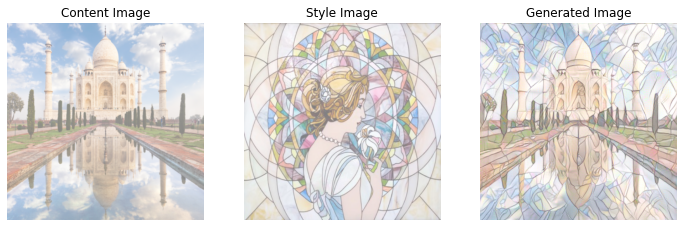


 taj_mahal - udnie
iteration: 0, total loss=448068.78125, content_loss=0.0, style loss=44806880.0
iteration: 500, total loss=11140.8505859375, content_loss=23.67178726196289, style loss=1111717.875
iteration: 1000, total loss=6728.49755859375, content_loss=25.45737075805664, style loss=670304.0
iteration: 1500, total loss=5054.51611328125, content_loss=26.390649795532227, style loss=502812.5625
iteration: 2000, total loss=4127.2763671875, content_loss=26.991804122924805, style loss=410028.5
iteration: 2500, total loss=3501.186279296875, content_loss=27.43759536743164, style loss=347374.875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


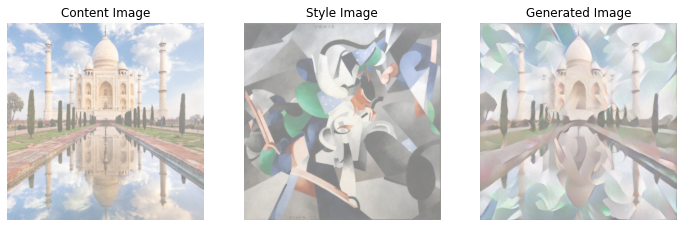


 taj_mahal - vg_la_cafe
iteration: 0, total loss=635521.3125, content_loss=0.0, style loss=63552132.0
iteration: 500, total loss=37387.35546875, content_loss=21.98285675048828, style loss=3736537.0
iteration: 1000, total loss=12513.9541015625, content_loss=24.16571807861328, style loss=1248978.875
iteration: 1500, total loss=7438.73046875, content_loss=25.402095794677734, style loss=741332.875
iteration: 2000, total loss=5608.53955078125, content_loss=26.22968292236328, style loss=558231.0
iteration: 2500, total loss=4465.79931640625, content_loss=26.806522369384766, style loss=443899.28125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


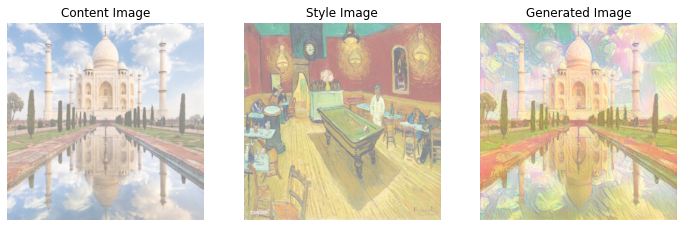


 taj_mahal - vg_starry_night_resized
iteration: 0, total loss=715122.0625, content_loss=0.0, style loss=71512208.0
iteration: 500, total loss=11427.6044921875, content_loss=23.41051483154297, style loss=1140419.5
iteration: 1000, total loss=4954.21142578125, content_loss=24.72712516784668, style loss=492948.4375
iteration: 1500, total loss=3452.93798828125, content_loss=25.484874725341797, style loss=342745.3125
iteration: 2000, total loss=2650.510498046875, content_loss=26.02867889404297, style loss=262448.1875
iteration: 2500, total loss=2130.248291015625, content_loss=26.43598175048828, style loss=210381.234375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


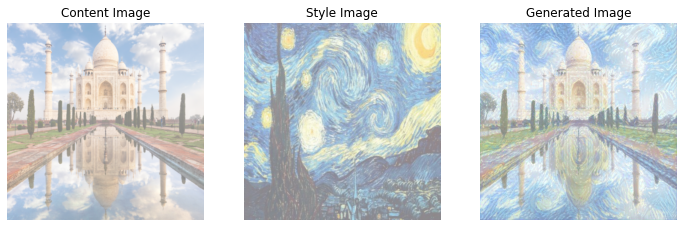


 taj_mahal - wave_crop
iteration: 0, total loss=762860.4375, content_loss=0.0, style loss=76286048.0
iteration: 500, total loss=11495.3486328125, content_loss=25.266307830810547, style loss=1147008.25
iteration: 1000, total loss=5952.5498046875, content_loss=26.959808349609375, style loss=592559.0
iteration: 1500, total loss=3971.73291015625, content_loss=27.863372802734375, style loss=394386.96875
iteration: 2000, total loss=2957.60546875, content_loss=28.490129470825195, style loss=292911.53125
iteration: 2500, total loss=2318.865478515625, content_loss=28.954294204711914, style loss=228991.125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


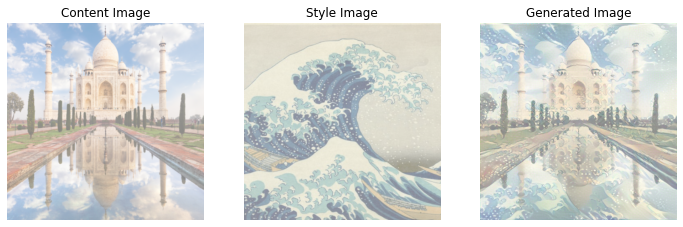


 lion - mosaic
iteration: 0, total loss=6101022.5, content_loss=0.0, style loss=610102272.0
iteration: 500, total loss=108125.4140625, content_loss=31.97446060180664, style loss=10809344.0
iteration: 1000, total loss=47071.9296875, content_loss=33.10813903808594, style loss=4703882.0
iteration: 1500, total loss=29352.697265625, content_loss=33.678707122802734, style loss=2931902.0
iteration: 2000, total loss=21087.76171875, content_loss=34.13518524169922, style loss=2105362.75
iteration: 2500, total loss=16304.9697265625, content_loss=34.5441780090332, style loss=1627042.625


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


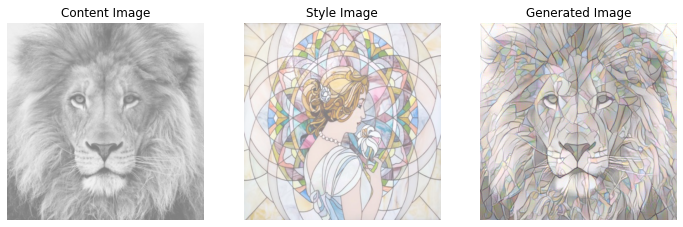


 lion - udnie
iteration: 0, total loss=511982.625, content_loss=0.0, style loss=51198264.0
iteration: 500, total loss=8804.7587890625, content_loss=19.539527893066406, style loss=878522.0
iteration: 1000, total loss=4863.71875, content_loss=20.276002883911133, style loss=484344.3125
iteration: 1500, total loss=3509.5478515625, content_loss=20.68612289428711, style loss=348886.1875
iteration: 2000, total loss=2805.098876953125, content_loss=20.97385025024414, style loss=278412.5
iteration: 2500, total loss=2373.773193359375, content_loss=21.179309844970703, style loss=235259.40625


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


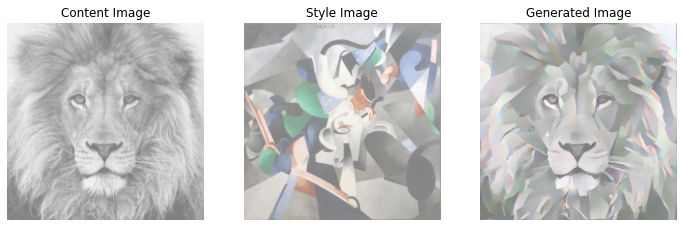


 lion - vg_la_cafe
iteration: 0, total loss=972572.3125, content_loss=0.0, style loss=97257232.0
iteration: 500, total loss=57478.9375, content_loss=22.65898323059082, style loss=5745628.0
iteration: 1000, total loss=15554.8720703125, content_loss=23.668968200683594, style loss=1553120.375
iteration: 1500, total loss=6328.0107421875, content_loss=24.18160629272461, style loss=630382.9375
iteration: 2000, total loss=4427.42041015625, content_loss=24.507978439331055, style loss=440291.25
iteration: 2500, total loss=3425.313232421875, content_loss=24.750267028808594, style loss=340056.3125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


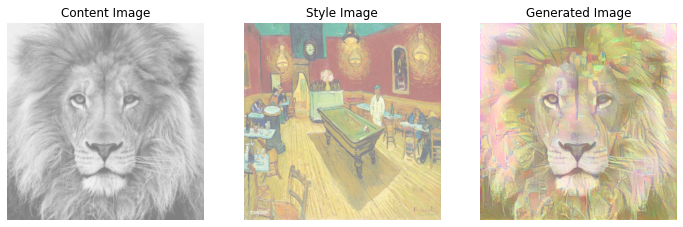


 lion - vg_starry_night_resized
iteration: 0, total loss=462522.5625, content_loss=0.0, style loss=46252256.0
iteration: 500, total loss=11956.6220703125, content_loss=10.58609390258789, style loss=1194603.625
iteration: 1000, total loss=3278.54833984375, content_loss=11.471101760864258, style loss=326707.71875
iteration: 1500, total loss=2275.505859375, content_loss=11.922822952270508, style loss=226358.296875
iteration: 2000, total loss=1653.919677734375, content_loss=12.199678421020508, style loss=164172.0
iteration: 2500, total loss=1206.672119140625, content_loss=12.424851417541504, style loss=119424.734375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


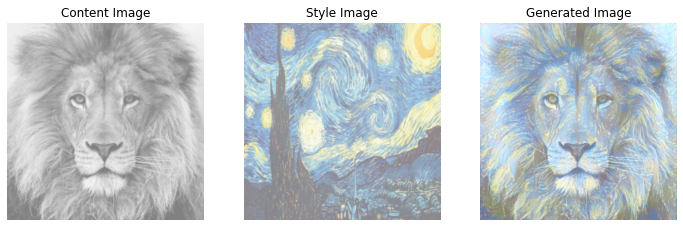


 lion - wave_crop
iteration: 0, total loss=823609.5625, content_loss=0.0, style loss=82360960.0
iteration: 500, total loss=12116.287109375, content_loss=16.597755432128906, style loss=1209969.0
iteration: 1000, total loss=6508.830078125, content_loss=17.45065689086914, style loss=649137.9375
iteration: 1500, total loss=4530.15185546875, content_loss=17.93808364868164, style loss=451221.375
iteration: 2000, total loss=3520.84716796875, content_loss=18.248329162597656, style loss=350259.90625
iteration: 2500, total loss=2858.604248046875, content_loss=18.47320556640625, style loss=284013.125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


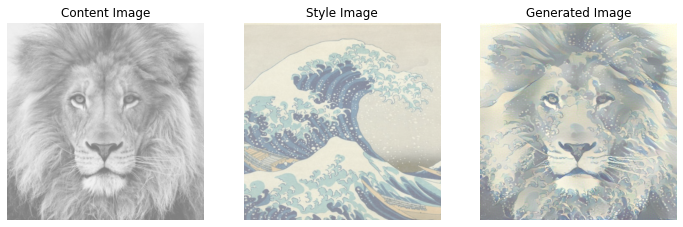


 green_bridge - mosaic
iteration: 0, total loss=6378921.5, content_loss=0.0, style loss=637892160.0
iteration: 500, total loss=134277.515625, content_loss=31.119672775268555, style loss=13424639.0
iteration: 1000, total loss=55356.4609375, content_loss=32.12734603881836, style loss=5532433.5
iteration: 1500, total loss=35738.6015625, content_loss=32.6834831237793, style loss=3570591.75
iteration: 2000, total loss=27079.279296875, content_loss=33.074058532714844, style loss=2704620.5
iteration: 2500, total loss=22169.064453125, content_loss=33.42897415161133, style loss=2213563.5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


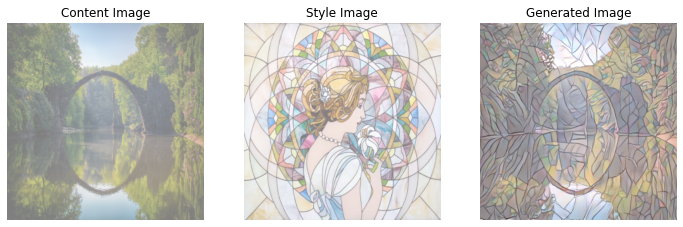


 green_bridge - udnie
iteration: 0, total loss=502301.09375, content_loss=0.0, style loss=50230112.0
iteration: 500, total loss=11843.2099609375, content_loss=16.726640701293945, style loss=1182648.375
iteration: 1000, total loss=6216.82861328125, content_loss=17.652259826660156, style loss=619917.625
iteration: 1500, total loss=4287.6611328125, content_loss=18.146203994750977, style loss=426951.53125
iteration: 2000, total loss=3375.71337890625, content_loss=18.44080352783203, style loss=335727.25
iteration: 2500, total loss=2851.693603515625, content_loss=18.64910888671875, style loss=283304.4375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


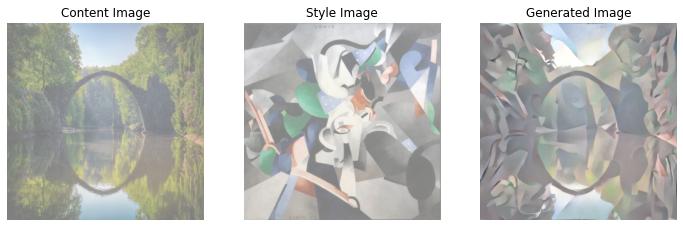


 green_bridge - vg_la_cafe
iteration: 0, total loss=803572.25, content_loss=0.0, style loss=80357224.0
iteration: 500, total loss=30942.478515625, content_loss=18.878463745117188, style loss=3092360.0
iteration: 1000, total loss=11229.451171875, content_loss=20.007646560668945, style loss=1120944.375
iteration: 1500, total loss=7271.85205078125, content_loss=20.69962501525879, style loss=725115.25
iteration: 2000, total loss=5604.62060546875, content_loss=21.140247344970703, style loss=558348.0625
iteration: 2500, total loss=4470.46630859375, content_loss=21.45699119567871, style loss=444900.9375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


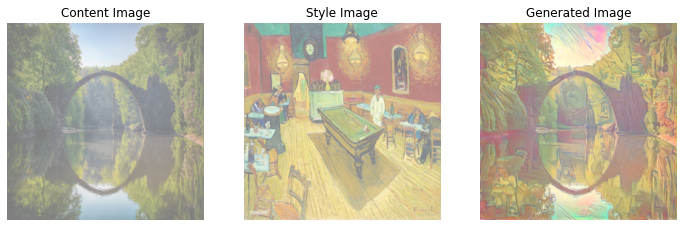


 green_bridge - vg_starry_night_resized
iteration: 0, total loss=413391.125, content_loss=0.0, style loss=41339112.0
iteration: 500, total loss=5906.8056640625, content_loss=9.532208442687988, style loss=589727.375
iteration: 1000, total loss=2373.971923828125, content_loss=10.276559829711914, style loss=236369.53125
iteration: 1500, total loss=1837.6143798828125, content_loss=10.658271789550781, style loss=182695.609375
iteration: 2000, total loss=1533.2216796875, content_loss=10.916147232055664, style loss=152230.5625
iteration: 2500, total loss=1308.86572265625, content_loss=11.111156463623047, style loss=129775.453125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


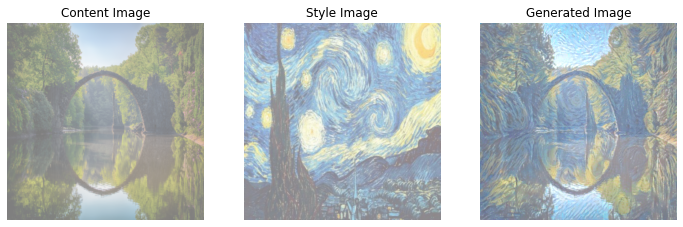


 green_bridge - wave_crop
iteration: 0, total loss=734781.0, content_loss=0.0, style loss=73478104.0
iteration: 500, total loss=16930.48046875, content_loss=13.498859405517578, style loss=1691698.25
iteration: 1000, total loss=10095.5458984375, content_loss=14.340319633483887, style loss=1008120.625
iteration: 1500, total loss=7727.95849609375, content_loss=14.759323120117188, style loss=771319.9375
iteration: 2000, total loss=6419.84033203125, content_loss=15.086996078491211, style loss=640475.375
iteration: 2500, total loss=5495.93701171875, content_loss=15.316936492919922, style loss=548062.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


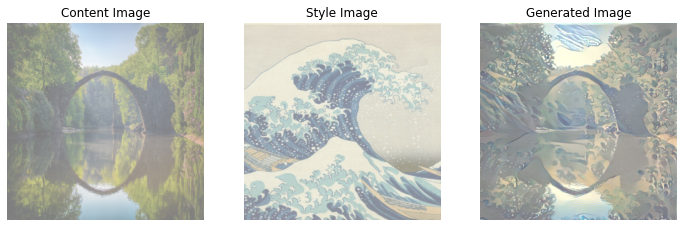


 golden_gate2 - mosaic
iteration: 0, total loss=5615123.5, content_loss=0.0, style loss=561512384.0
iteration: 500, total loss=102093.6015625, content_loss=30.748729705810547, style loss=10206285.0
iteration: 1000, total loss=42611.875, content_loss=32.441650390625, style loss=4257943.5
iteration: 1500, total loss=25930.869140625, content_loss=33.53548049926758, style loss=2589733.5
iteration: 2000, total loss=18380.166015625, content_loss=34.30438232421875, style loss=1834586.25
iteration: 2500, total loss=14070.83203125, content_loss=34.89472579956055, style loss=1403593.75


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


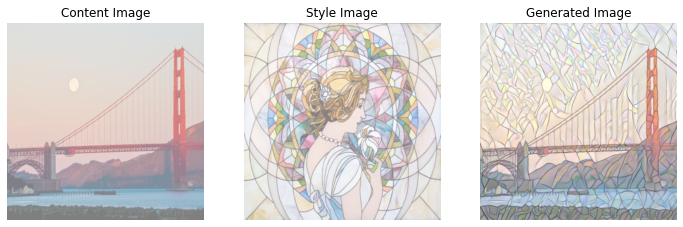


 golden_gate2 - udnie
iteration: 0, total loss=361824.0, content_loss=0.0, style loss=36182400.0


Exception in thread Thread-23:
Traceback (most recent call last):
  File "C:\Program Files\Python39\lib\threading.py", line 954, in _bootstrap_inner
    self.run()
  File "C:\Users\msant429\AppData\Roaming\Python\Python39\site-packages\tensorboard\summary\writer\event_file_writer.py", line 233, in run
    self._record_writer.write(data)
  File "C:\Users\msant429\AppData\Roaming\Python\Python39\site-packages\tensorboard\summary\writer\record_writer.py", line 40, in write
    self._writer.write(header + header_crc + data + footer_crc)
  File "C:\Users\msant429\AppData\Roaming\Python\Python39\site-packages\tensorboard\compat\tensorflow_stub\io\gfile.py", line 766, in write
    self.fs.append(self.filename, file_content, self.binary_mode)
  File "C:\Users\msant429\AppData\Roaming\Python\Python39\site-packages\tensorboard\compat\tensorflow_stub\io\gfile.py", line 160, in append
    self._write(filename, file_content, "ab" if binary_mode else "a")
  File "C:\Users\msant429\AppData\Roaming\Py

In [ ]:
for (original_img_label, original_img) in reversed(original_img_list):
  for (style_img_label, style_img) in style_img_list:
    
    # Ensuring all images does not have more than 4 channels
    style_img = style_img[:, 0:3, :, :]
    print("\n",original_img_label,"-", style_img_label)
    # Performing style transger
    make_style_transfer()
    


 golden_gate2 - mosaic
iteration: 0, total loss=5615123.5, content_loss=0.0, style loss=561512384.0
iteration: 500, total loss=102205.0, content_loss=30.736309051513672, style loss=10217427.0
iteration: 1000, total loss=42613.3671875, content_loss=32.421260833740234, style loss=4258094.5
iteration: 1500, total loss=25923.14453125, content_loss=33.5010986328125, style loss=2588964.25
iteration: 2000, total loss=18381.44140625, content_loss=34.287933349609375, style loss=1834715.375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


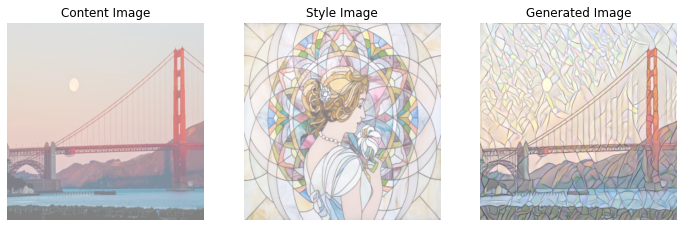


 golden_gate2 - udnie
iteration: 0, total loss=361824.0, content_loss=0.0, style loss=36182400.0
iteration: 500, total loss=11944.447265625, content_loss=20.46531867980957, style loss=1192398.25
iteration: 1000, total loss=5872.77734375, content_loss=21.962116241455078, style loss=585081.5625
iteration: 1500, total loss=3966.147705078125, content_loss=22.571800231933594, style loss=394357.59375
iteration: 2000, total loss=3059.05419921875, content_loss=22.88924789428711, style loss=303616.5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


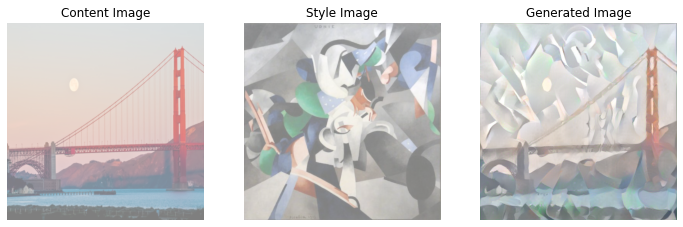


 golden_gate2 - vg_la_cafe
iteration: 0, total loss=896040.75, content_loss=0.0, style loss=89604080.0
iteration: 500, total loss=30323.205078125, content_loss=21.337841033935547, style loss=3030186.75
iteration: 1000, total loss=8580.1728515625, content_loss=23.01498031616211, style loss=855715.875
iteration: 1500, total loss=5348.09326171875, content_loss=23.87432098388672, style loss=532421.875
iteration: 2000, total loss=4191.36962890625, content_loss=24.42898941040039, style loss=416694.0625


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


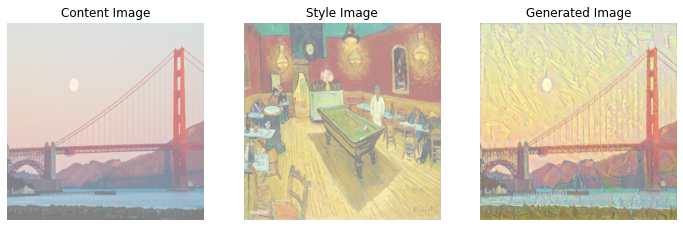


 golden_gate2 - vg_starry_night_resized
iteration: 0, total loss=723716.875, content_loss=0.0, style loss=72371688.0
iteration: 500, total loss=15097.90625, content_loss=16.811199188232422, style loss=1508109.5
iteration: 1000, total loss=3246.697021484375, content_loss=18.068113327026367, style loss=322862.90625
iteration: 1500, total loss=1979.781494140625, content_loss=18.608829498291016, style loss=196117.265625
iteration: 2000, total loss=1446.8349609375, content_loss=18.918651580810547, style loss=142791.625


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


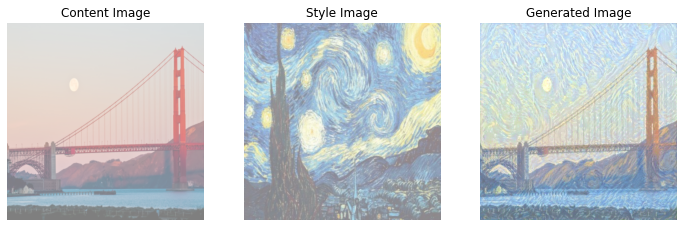


 golden_gate2 - wave_crop
iteration: 0, total loss=795237.5, content_loss=0.0, style loss=79523752.0
iteration: 500, total loss=14703.1318359375, content_loss=18.032466888427734, style loss=1468510.0
iteration: 1000, total loss=6268.4951171875, content_loss=19.55767059326172, style loss=624893.75
iteration: 1500, total loss=3803.453125, content_loss=20.374881744384766, style loss=378307.8125
iteration: 2000, total loss=2682.91796875, content_loss=20.862964630126953, style loss=266205.5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


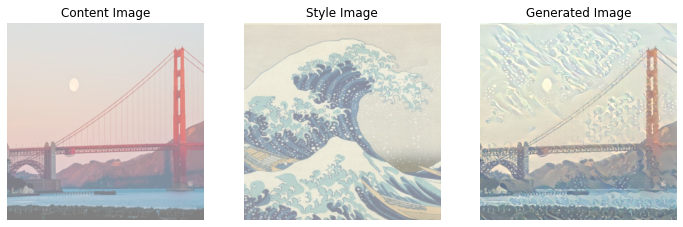


 figures - mosaic
iteration: 0, total loss=6077647.0, content_loss=0.0, style loss=607764736.0
iteration: 500, total loss=96430.203125, content_loss=30.492521286010742, style loss=9639971.0
iteration: 1000, total loss=40270.3046875, content_loss=32.06324005126953, style loss=4023824.5
iteration: 1500, total loss=24391.3828125, content_loss=32.9362678527832, style loss=2435844.75
iteration: 2000, total loss=17192.767578125, content_loss=33.578460693359375, style loss=1715919.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


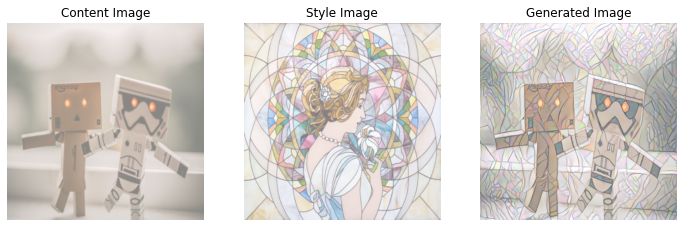


 figures - udnie
iteration: 0, total loss=237209.96875, content_loss=0.0, style loss=23720998.0
iteration: 500, total loss=5911.1982421875, content_loss=14.581424713134766, style loss=589661.6875
iteration: 1000, total loss=3245.83740234375, content_loss=15.844928741455078, style loss=322999.25
iteration: 1500, total loss=2465.72705078125, content_loss=16.512645721435547, style loss=244921.4375
iteration: 2000, total loss=2058.78466796875, content_loss=16.927762985229492, style loss=204185.6875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


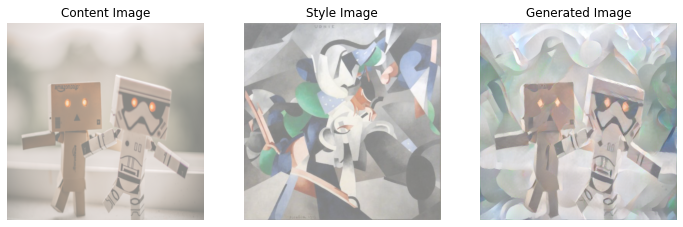


 figures - vg_la_cafe
iteration: 0, total loss=967005.0, content_loss=0.0, style loss=96700504.0
iteration: 500, total loss=24974.015625, content_loss=18.993881225585938, style loss=2495502.25
iteration: 1000, total loss=7841.12451171875, content_loss=20.867435455322266, style loss=782025.6875
iteration: 1500, total loss=4726.1865234375, content_loss=21.775678634643555, style loss=470441.0625
iteration: 2000, total loss=3516.283447265625, content_loss=22.306550979614258, style loss=349397.6875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


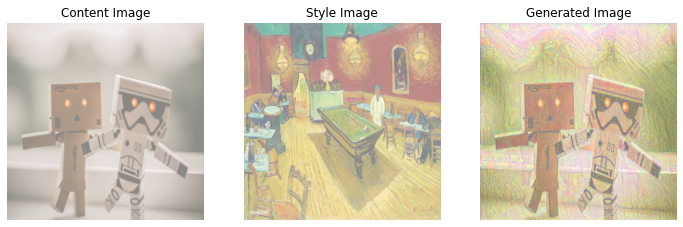


 figures - vg_starry_night_resized
iteration: 0, total loss=853484.9375, content_loss=0.0, style loss=85348496.0
iteration: 500, total loss=30435.71875, content_loss=16.12784194946289, style loss=3041959.25
iteration: 1000, total loss=3631.754150390625, content_loss=17.370342254638672, style loss=361438.375
iteration: 1500, total loss=1950.2764892578125, content_loss=18.0313663482666, style loss=193224.515625
iteration: 2000, total loss=1506.34228515625, content_loss=18.410778045654297, style loss=148793.15625


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


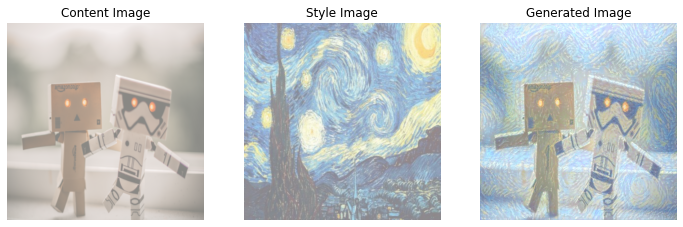


 figures - wave_crop
iteration: 0, total loss=873877.6875, content_loss=0.0, style loss=87387768.0
iteration: 500, total loss=14245.3037109375, content_loss=18.029918670654297, style loss=1422727.375
iteration: 1000, total loss=5996.64697265625, content_loss=19.194908142089844, style loss=597745.25
iteration: 1500, total loss=3804.702392578125, content_loss=19.732376098632812, style loss=378497.0
iteration: 2000, total loss=2854.381103515625, content_loss=20.110197067260742, style loss=283427.09375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


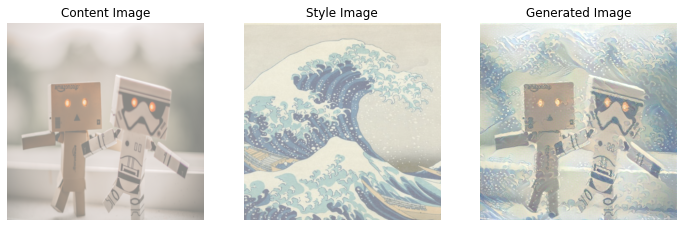


 farol_barra2 - mosaic
iteration: 0, total loss=6847604.5, content_loss=0.0, style loss=684760448.0
iteration: 500, total loss=191031.453125, content_loss=34.06430435180664, style loss=19099740.0
iteration: 1000, total loss=75404.359375, content_loss=35.30349349975586, style loss=7536905.5
iteration: 1500, total loss=40393.8671875, content_loss=35.86376953125, style loss=4035800.5
iteration: 2000, total loss=26151.666015625, content_loss=36.25200653076172, style loss=2611541.5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


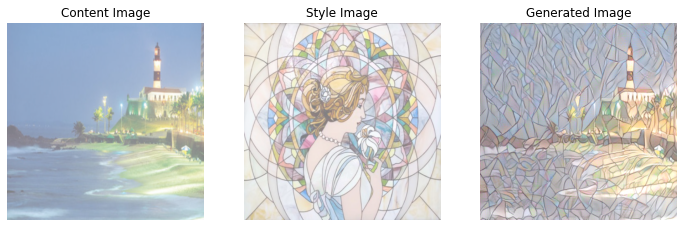


 farol_barra2 - udnie
iteration: 0, total loss=518196.09375, content_loss=0.0, style loss=51819612.0
iteration: 500, total loss=16097.361328125, content_loss=18.544212341308594, style loss=1607881.75
iteration: 1000, total loss=6618.51611328125, content_loss=19.50251007080078, style loss=659901.375
iteration: 1500, total loss=4280.22705078125, content_loss=20.048912048339844, style loss=426017.8125
iteration: 2000, total loss=3210.227783203125, content_loss=20.41977310180664, style loss=318980.8125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


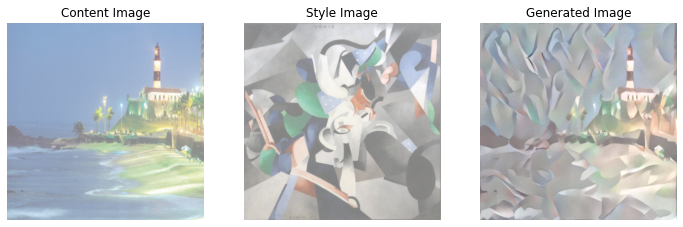


 farol_barra2 - vg_la_cafe
iteration: 0, total loss=1188588.75, content_loss=0.0, style loss=118858880.0
iteration: 500, total loss=81981.3515625, content_loss=20.30173110961914, style loss=8196104.5
iteration: 1000, total loss=23078.478515625, content_loss=21.90683364868164, style loss=2305657.25
iteration: 1500, total loss=6814.8486328125, content_loss=22.766183853149414, style loss=679208.25
iteration: 2000, total loss=3945.5830078125, content_loss=23.32802391052246, style loss=392225.5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


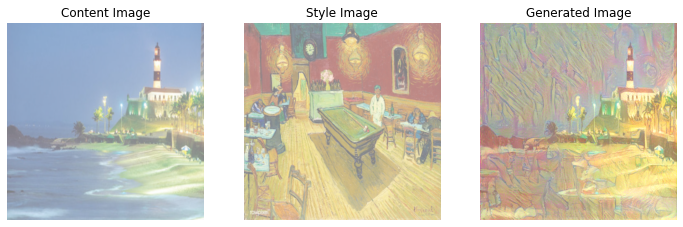


 farol_barra2 - vg_starry_night_resized
iteration: 0, total loss=658532.0, content_loss=0.0, style loss=65853204.0
iteration: 500, total loss=4222.93896484375, content_loss=12.975946426391602, style loss=420996.28125
iteration: 1000, total loss=1954.58056640625, content_loss=13.861188888549805, style loss=194071.9375
iteration: 1500, total loss=1343.656005859375, content_loss=14.329551696777344, style loss=132932.640625
iteration: 2000, total loss=1043.289306640625, content_loss=14.656244277954102, style loss=102863.3125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


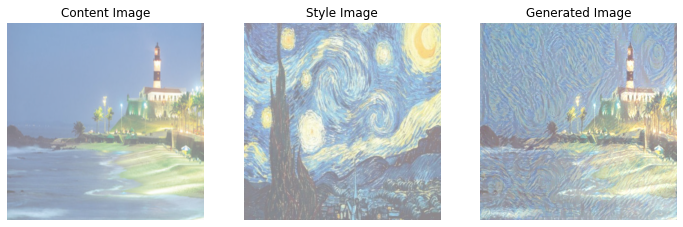


 farol_barra2 - wave_crop
iteration: 0, total loss=969205.3125, content_loss=0.0, style loss=96920536.0
iteration: 500, total loss=22824.400390625, content_loss=15.89801025390625, style loss=2280850.25
iteration: 1000, total loss=8752.7939453125, content_loss=17.163415908813477, style loss=873563.0625
iteration: 1500, total loss=5645.6103515625, content_loss=17.735549926757812, style loss=562787.5
iteration: 2000, total loss=4361.18994140625, content_loss=18.09758186340332, style loss=434309.25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


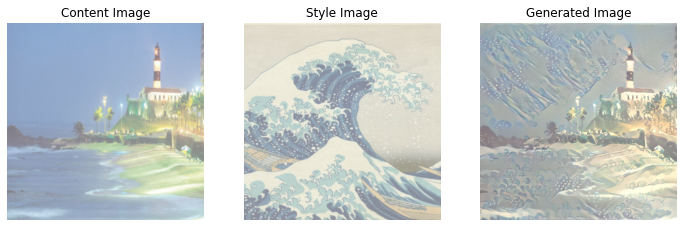

In [ ]:
original_img_list = [(image[:-4], load_image(content_images_path + image))  for image in content_images_lista[:3]]
style_img_list = [(image[:-4], load_image(style_images_path + image))  for image in style_images_lista]

for (original_img_label, original_img) in reversed(original_img_list):
    for (style_img_label, style_img) in style_img_list:

         # Ensuring all images does not have more than 4 channels
        style_img = style_img[:, 0:3, :, :]
        print("\n",original_img_label,"-", style_img_label)
        # Performing style transger
        make_style_transfer()


### Testar transferência em alguma imagem nova

In [ ]:
original_img = load_image("farol_barra2.jpg")
style_img = load_image("vg_starry_night_resized.jpg")

make_style_transfer()

### Para rodar o tensorboard com os resultados de cada experimento

In [ ]:
!tensorboard --logdir='runs'

^C


In [ ]:
# Kill tensorboard pid
!kill 659